---
# Imports

In [ ]:
import os
# Ensure deterministic behavior for reproducibility
os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":16:8"

from rich import print as rprint
import pandas as pd
import numpy as np

import warnings
# Filter the specific UserWarning from torch regarding TF32/matmul precision
warnings.filterwarnings("ignore", category=UserWarning, module="torch")

import torch
torch.set_float32_matmul_precision('high')
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

import timm

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_rgb import RGBAxes, make_rgb_axes
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, mean_absolute_percentage_error
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedGroupKFold

import cv2
import pickle

import logging
import time
from datetime import datetime
import gc # garbage collection to free up memory

print('OpenCV version: ', cv2.__version__)


OpenCV version:  4.12.0


In [2]:
import random
import os

def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed) # if you are using multi-GPU
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    # torch.use_deterministic_algorithms(True, warn_only=True)

SEED = 42

seed_everything(SEED)


---
# Load images @ 1920x1080

In [3]:
# Data Set
raw_images_path = '../data/raw/'
images_dir = 'Test'  # Change to 'Final' as needed
df_name = images_dir + '.csv' # Note the capitalization to match the actual file name (Test.csv or final.csv)

df_test = pd.read_csv(f'{raw_images_path}{images_dir}/{df_name}')

In [4]:
# Drop image 332 due to corrupted file (this is in training set, but just in case, drop it here too)
if 332 in df_test['image_id'].values:
    print("Dropping image_id 332 due to corrupted file.")
    df_test = df_test[df_test['image_id'] != 332].reset_index(drop=True)

In [5]:
# Read RGB images - image values [0,255]
rgb_images_test = {}

for image_id in df_test['image_id'].values:
    img = cv2.imread(raw_images_path + images_dir + '/RGBImages/RGB_' + str(image_id) + '.png', cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    rgb_images_test[image_id] = img
print(f'Loaded {len(rgb_images_test)} RGB test images.')

# Read Depth images - image values - 16 bit
depth_images_test = {}
for image_id in df_test['image_id'].values:
    img = cv2.imread(raw_images_path + images_dir + '/DepthImages/Depth_' + str(image_id) + '.png', cv2.IMREAD_UNCHANGED)
    depth_images_test[image_id] = img
print(f'Loaded {len(depth_images_test)} test depth images.')


Loaded 76 RGB test images.
Loaded 76 test depth images.


In [6]:
# Check shapes. Should be 1080x1920
test_image_id = df_test['image_id'].values[1]
rgb_images_test[test_image_id].shape, depth_images_test[test_image_id].shape

((1080, 1920, 3), (1080, 1920))

---
# Crop to 800x800

In [7]:
def draw_overall_crate_box_blue_fix(
    img,
    min_contour_area=500,
    scale=1.1,
    min_box_size=10000,
    morph_kernel_size=15,
    otsu=True,
    left_exclude_frac=0.25,   # NEW: ignore left 25% of image
    debug=False
):
    if img is None:
        return None, None, [], [], None, None

    H, W = img.shape[:2]

    # Split channels (RGB input assumed)
    b = img[:, :, 0].astype(np.float32)
    g = img[:, :, 1].astype(np.float32)
    r = img[:, :, 2].astype(np.float32)

    # Orange score
    score = ((r + g) / 2.0) - b
    score_norm = cv2.normalize(score, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    score_blur = cv2.GaussianBlur(score_norm, (7, 7), 0)

    # Threshold
    if otsu:
        _, mask = cv2.threshold(
            score_blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU
        )
        if mask.mean() < 1 or mask.mean() > 250:
            _, mask = cv2.threshold(score_blur, 100, 255, cv2.THRESH_BINARY)
    else:
        _, mask = cv2.threshold(score_blur, 100, 255, cv2.THRESH_BINARY)

    # Morphology
    k = max(3, int(morph_kernel_size))
    kernel = np.ones((k, k), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, np.ones((3, 3), np.uint8), iterations=1)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    candidates = []
    cx_img, cy_img = W / 2.0, H / 2.0

    for c in contours:
        area = cv2.contourArea(c)
        if area < min_contour_area:
            continue

        x, y, w, h = cv2.boundingRect(c)
        cx = x + w / 2.0
        cy = y + h / 2.0

        # Reject contours in left part of image
        if cx < W * left_exclude_frac:
            continue

        dist_to_center = np.hypot(cx - cx_img, cy - cy_img)

        candidates.append((dist_to_center, area, c))

    if not candidates:
        if debug:
            return img.copy(), None, [], [], score_norm, mask
        return img.copy(), None, [], []

    # Sort: closest to center first, then by area
    candidates.sort(key=lambda x: (x[0], -x[1]))

    # Take top few
    selected = [c for _, _, c in candidates[:3]]

    output_img = img.copy()
    part_bboxes = []
    centers = []

    x1_all, y1_all = W, H
    x2_all, y2_all = 0, 0

    for c in selected:
        x, y, w, h = cv2.boundingRect(c)
        if w * h < min_box_size:
            continue

        # Expand bbox
        width = int(w * scale)
        height = int(h * scale)
        cx, cy = x + w // 2, y + h // 2

        x1 = max(cx - width // 2, 0)
        y1 = max(cy - height // 2, 0)
        x2 = min(cx + width // 2, W)
        y2 = min(cy + height // 2, H)

        cv2.rectangle(output_img, (x1, y1), (x2, y2), (0, 255, 0), 2)

        part_bboxes.append((x1, y1, x2, y2))
        centers.append((cx, cy))

        x1_all = min(x1_all, x1)
        y1_all = min(y1_all, y1)
        x2_all = max(x2_all, x2)
        y2_all = max(y2_all, y2)

    overall_bbox = None
    if x2_all > x1_all and y2_all > y1_all:
        cv2.rectangle(output_img, (x1_all, y1_all), (x2_all, y2_all), (255, 0, 0), 2)
        overall_bbox = (x1_all, y1_all, x2_all, y2_all)

    if debug:
        return output_img, overall_bbox, part_bboxes, centers, score_norm, mask

    return output_img, overall_bbox, part_bboxes, centers


In [8]:
# Crop images around detected crate using blue-channel method
# Fixed size of 800 square

import tqdm

cropped_width = 800
cropped_height = 800

rgb_test_cropped = {}
depth_test_cropped = {}

for k in tqdm.tqdm(rgb_images_test.keys()):
    rgb_image = rgb_images_test[k]
    output_image, overall_bbox, part_bboxes, centers = draw_overall_crate_box_blue_fix(rgb_image, min_contour_area=500, scale=1.0, min_box_size=15000)
    if overall_bbox is None:
        # Fallback to centre crop if no crate detected
        h, w = rgb_image.shape[:2]
        x1 = max((w - cropped_width) // 2, 0)
        y1 = max((h - cropped_height) // 2, 0)
        x2 = min(x1 + cropped_width, w)
        y2 = min(y1 + cropped_height, h)
        overall_bbox = (x1, y1, x2, y2)
    else:
        # Adjust overall_bbox to fixed size around its center
        cx = (overall_bbox[0] + overall_bbox[2]) // 2
        cy = (overall_bbox[1] + overall_bbox[3]) // 2
        x1 = max(cx - cropped_width // 2, 0)
        y1 = max(cy - cropped_height // 2, 0)
        x2 = min(cx + cropped_width // 2, rgb_image.shape[1])
        y2 = min(cy + cropped_height // 2, rgb_image.shape[0])
        overall_bbox = (x1, y1, x2, y2)

    cropped_rgb_image = rgb_image[overall_bbox[1]:overall_bbox[3], overall_bbox[0]:overall_bbox[2]]
    rgb_test_cropped[k] = cropped_rgb_image
    # Crop the depth image similarly
    depth_image = depth_images_test[k]
    cropped_depth_image = depth_image[overall_bbox[1]:overall_bbox[3], overall_bbox[0]:overall_bbox[2]]
    depth_test_cropped[k] = cropped_depth_image


100%|██████████| 76/76 [00:01<00:00, 60.03it/s]


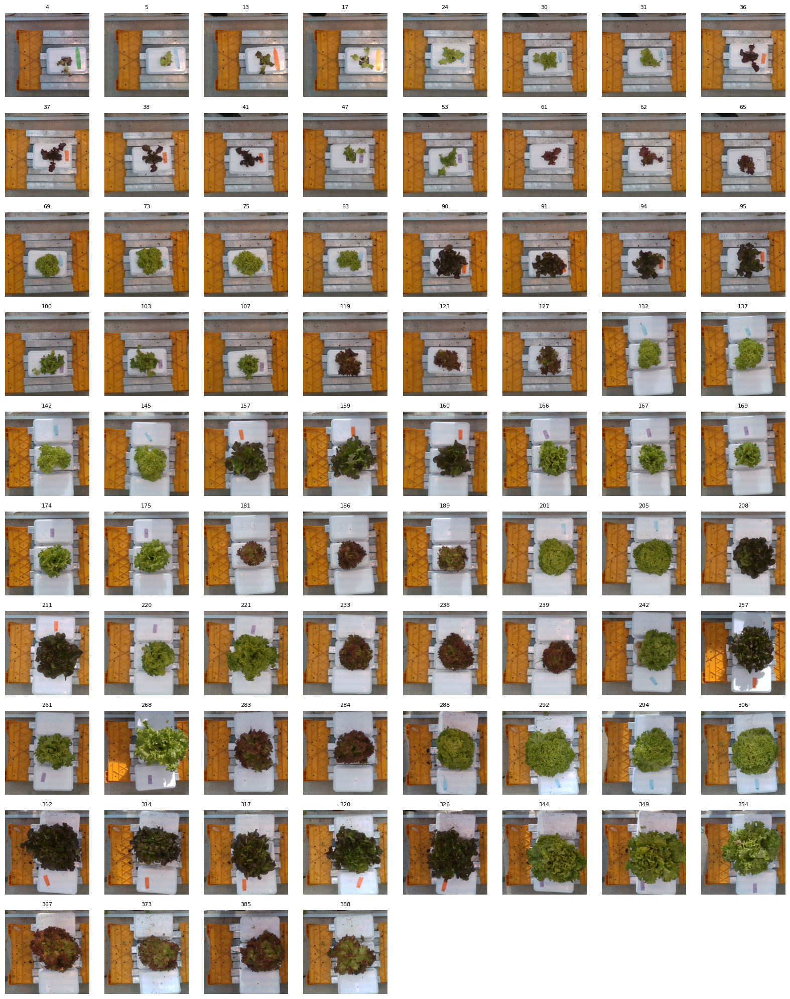

In [9]:
import matplotlib.pyplot as plt
import math

def show_image_dict(img_dict, title_prefix="", max_images=None, cols=8):
    """
    Display images from a dict in a grid.

    img_dict: dict[key -> RGB image]
    max_images: limit number shown (None = all)
    cols: images per row
    """
    keys = list(img_dict.keys())
    keys.sort()
    if max_images is not None:
        keys = keys[:max_images]

    n = len(keys)
    rows = math.ceil(n / cols)

    plt.figure(figsize=(2 * cols, 2 * rows))

    for i, k in enumerate(keys):
        img = img_dict[k]
        ax = plt.subplot(rows, cols, i + 1)
        ax.imshow(img)
        ax.set_title(str(k), fontsize=8)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

show_image_dict(rgb_test_cropped, title_prefix="test")

---
# Infer lettuce & crate masks

In [10]:
import segmentation_models_pytorch as smp


def load_model(path):
    model = smp.Unet(encoder_name="efficientnet-b3", in_channels=3, classes=1).cuda()
    model.load_state_dict(torch.load(path))
    model.eval()
    return model

lettuce_model = load_model("../weights/best_lettuce_segmentation_model.pth")
crate_model = load_model("../weights/best_crate_segmentation_model.pth")

def predict_biomass(rgb_800, depth_800):
    # Preprocess for 512p model
    img_512 = cv2.resize(rgb_800, (512, 512), interpolation=cv2.INTER_AREA)
    img_t = torch.from_numpy(img_512.astype(np.float32)/255.0).permute(2,0,1).unsqueeze(0).cuda()
    
    with torch.no_grad():
        l_pred = torch.sigmoid(lettuce_model(img_t))
        c_pred = torch.sigmoid(crate_model(img_t))
        
    # SCALE BACK TO 800p (Precision Handshake)
    # Convert from boolean to uint8 so OpenCV can resize it
    l_mask_bin = (l_pred > 0.5).cpu().numpy()[0,0].astype(np.uint8)
    c_mask_bin = (c_pred > 0.5).cpu().numpy()[0,0].astype(np.uint8)
    
    # Now resize the uint8 masks
    l_mask = cv2.resize(l_mask_bin, (800, 800), interpolation=cv2.INTER_NEAREST)
    c_mask = cv2.resize(c_mask_bin, (800, 800), interpolation=cv2.INTER_NEAREST)
    
    # CALCULATE Z-BASELINE (The Floor Fix)
    # Using the median of the crate area to avoid outliers
    z_floor = np.median(depth_800[c_mask == 1])
    
    # Isolate lettuce heights
    lettuce_depths = depth_800[l_mask == 1]
    heights = z_floor - lettuce_depths
    
    # Filter noise (e.g., negative heights)
    heights = heights[heights > 0]
    
    # Calculate Volume/Biomass Proxy (Sum of heights * pixel area)
    # Adjust this based on your regression model
    biomass_estimate = np.sum(heights) 
    
    return biomass_estimate, l_mask, c_mask

In [11]:
lettuce_masks = {}
crate_masks = {}

for k in rgb_test_cropped.keys():
    rgb_img = rgb_test_cropped[k]
    depth_img = depth_test_cropped[k]
    biomass, l_mask, c_mask = predict_biomass(rgb_img, depth_img)
    lettuce_masks[k] = l_mask
    crate_masks[k] = c_mask

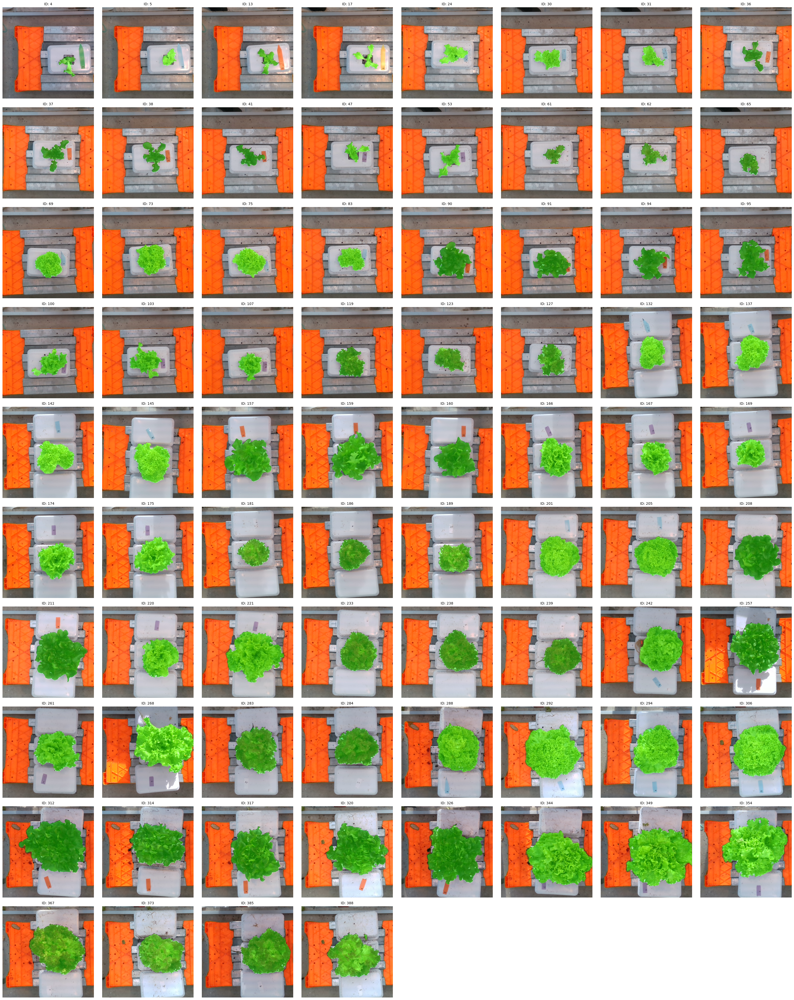

In [12]:
# Display the masks overlaid on the RGB images for visual verification
def display_mask_overlays(rgb_dict, lettuce_masks, crate_masks, columns=6):
    keys = list(rgb_dict.keys())
    keys.sort()
    
    n = len(keys)
    rows = math.ceil(n / columns)

    plt.figure(figsize=(4 * columns, 4 * rows))

    for i, k in enumerate(keys):
        rgb_img = rgb_dict[k]
        l_mask = lettuce_masks[k]
        c_mask = crate_masks[k]

        ax = plt.subplot(rows, columns, i + 1)
        ax.imshow(rgb_img)
        
        # Create overlay for lettuce
        lettuce_overlay = np.zeros_like(rgb_img)
        lettuce_overlay[l_mask == 1] = [0, 255, 0]  # GREEN for lettuce
        
        # Create overlay for crate
        crate_overlay = np.zeros_like(rgb_img)
        crate_overlay[c_mask == 1] = [255, 0, 0]  # RED for crate
        
        # Combine overlays with some transparency
        combined_overlay = cv2.addWeighted(lettuce_overlay, 0.8, crate_overlay, 0.8, 0)
        
        # Overlay on original image
        overlayed_img = cv2.addWeighted(rgb_img, 1.0, combined_overlay, 0.5, 0)
        
        ax.imshow(overlayed_img)
        ax.set_title(f"ID: {k}", fontsize=10)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

display_mask_overlays(rgb_test_cropped, lettuce_masks, crate_masks, columns=8)

---
# Generate local and global depth maps @ 480x480

In [13]:
# Check that every image has a lettuce mask
missing_masks = []
for image_id in df_test['image_id'].values:
    if image_id not in lettuce_masks:
        missing_masks.append(image_id)
print(f'Missing masks for test images: {missing_masks}')

# Check that every image has a crate mask
missing_masks = []
for image_id in df_test['image_id'].values:
    if image_id not in crate_masks:
        missing_masks.append(image_id)
print(f'Missing masks for test images: {missing_masks}')

Missing masks for test images: []
Missing masks for test images: []


In [14]:
# Currently have:
# rgb_test_cropped: 800x800 RGB images cropped around detected crate
# depth_test_cropped: 800x800 depth images cropped around detected crate
# lettuce_masks: binary masks of detected lettuce areas (800x800)
# crate_masks: binary masks of detected crate areas (800x800)

rgb_test_cropped[test_image_id].shape, depth_test_cropped[test_image_id].shape, lettuce_masks[test_image_id].shape, crate_masks[test_image_id].shape

((800, 800, 3), (800, 800), (800, 800), (800, 800))

In [15]:
# Local normalization of depth using lettuce mask

def isolate_lettuce_with_mask(depth_map, mask):
    """
    Isolates lettuce using a pre-computed segmentation mask and 
    applies height-relative normalization.
    """
    # 1. Ensure mask is binary (0 or 1)
    # Using > 0.5 to handle soft masks if necessary
    binary_mask = (mask > 0.5) & (depth_map > 0)
    
    if np.any(binary_mask):
        # 2. Extract min/max from masked area only
        plant_pixels = depth_map[binary_mask]
        d_min = np.min(plant_pixels)
        d_max = np.max(plant_pixels)
        
        # 3. Normalized Mapping (Inverted)
        # Taller parts (low depth) -> 255
        # Lower parts (high depth) -> 0
        norm_depth = np.zeros_like(depth_map, dtype=np.float32)
        
        # Avoid division by zero for flat objects
        denom = (d_max - d_min) if d_max > d_min else 1.0
        norm_depth[binary_mask] = (d_max - depth_map[binary_mask]) / denom
        
        return (norm_depth * 255).astype(np.uint8)
    else:
        return np.zeros_like(depth_map, dtype=np.uint8)

depth_test_cropped_masked = {img_id: isolate_lettuce_with_mask(depth_test_cropped[img_id], lettuce_masks[img_id]) for img_id in depth_test_cropped}

In [16]:
# Global normalization to height maps using lettuce mask and floor reference

def generate_standardized_heights(depth_dict, lettuce_mask_dict, z_floor, g_max):
    processed_dict = {}
    
    for key in depth_dict.keys():
        depth = depth_dict[key].astype(np.float32)
        l_mask = (lettuce_mask_dict[key] > 0)
        
        # 1. Calculate height from the floor
        # Standard: Floor (e.g. 1000) - Plant Depth (e.g. 850) = 150mm height
        raw_height = z_floor - depth
        
        # 2. Normalize and Clip
        # This keeps a 5cm plant dim and a 20cm plant bright
        norm_height = np.clip(raw_height / g_max, 0, 1)
        
        # 3. Apply Noise & Lettuce Filters
        # - (l_mask): Deletes crate rims/background
        # - (depth > 0): Deletes the black sensor spikes
        final_map = norm_height * l_mask * (depth > 0)
        
        processed_dict[key] = final_map.astype(np.float32)
        
    return processed_dict

# Derived from training set.
Z_FLOOR = 865.0
G_MAX = 217.8 # Global max height relative to floor

height_maps_test = generate_standardized_heights(depth_test_cropped, lettuce_masks, Z_FLOOR, G_MAX)


In [17]:
# Resize to 480x480
def resize_image(img, size=(480,480)):
    resized_img = cv2.resize(img, size, interpolation=cv2.INTER_AREA)
    return resized_img

rgb_test_cropped_480 = {image_id: resize_image(img, (480,480)) for image_id, img in rgb_test_cropped.items()}
 # Local normalization
cropped_depth_images_masked_test_480 = {image_id: resize_image(img, (480,480)) for image_id, img in depth_test_cropped_masked.items()} # Local normalization
# Global normalization
height_maps_test_480 = {image_id: resize_image(img, (480,480)) for image_id, img in height_maps_test.items()}


In [18]:
# No augmentations required for inference.
# Consolidate into single dict for ease of use in Dataset class

def consolidate(rgb_dict, depth_dict):
    """
    Consolidated augmentation for test set.
    """
    output_array = []
    
    for img_id, rgb_orig in rgb_dict.items():
        depth_orig = depth_dict[img_id]
        
        fw_target = -1.0 # Placeholder
        dw_target = -1.0  # Placeholder
        variety = 'Unknown'  # Placeholder

        output_array.append({
            'image_id': img_id,
            'rgb_image': rgb_orig,
            'depth_image': depth_orig,
            'fresh_weight': fw_target,
            'dry_weight': dw_target,
            'variety': variety,
            'aug_type': f'original'
        })
                
    return np.array(output_array)

consolidated_test_local = consolidate(rgb_test_cropped_480, cropped_depth_images_masked_test_480)
consolidated_test_global = consolidate(rgb_test_cropped_480, height_maps_test_480)

print(f"Consolidated test set with local normalization: {len(consolidated_test_local)} samples")
print(f"Consolidated test set with global normalization: {len(consolidated_test_global)} samples")

Consolidated test set with local normalization: 76 samples
Consolidated test set with global normalization: 76 samples


---
# Infer variety

In [19]:
class LettuceVarietyClassifier(nn.Module):
    def __init__(self, num_classes=4): # 4 varieties
        super().__init__()
        self.backbone = timm.create_model(
            'legacy_seresnet18.in1k', 
            pretrained=True, 
            num_classes=num_classes
        )

    def forward(self, x):
        return self.backbone(x)

In [20]:
class VarietyInferenceDataset(Dataset):
    def __init__(self, data_list):
        self.data = data_list
        # Standard ImageNet stats for the RGB branch
        self.mean = np.array([0.485, 0.456, 0.406])
        self.std = np.array([0.229, 0.224, 0.225])

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        
        # --- RGB Branch ---
        rgb = item['rgb_image']
        rgb = rgb.astype(np.float32) / 255.0
        # Normalize: (x - mean) / std
        rgb = (rgb - self.mean) / self.std
        rgb = np.transpose(rgb, (2, 0, 1)) # HWC to CHW
        rgb_tensor = torch.from_numpy(rgb)
        
        # --- Depth Branch ---
        depth = item['depth_image'].astype(np.float32)
        if len(depth.shape) == 2:
            depth = np.expand_dims(depth, axis=0)
        
        # Normalize uint8 (0-255) to [0, 1]
        if depth.max() > 1.0:
            depth /= 255.0
            
        depth_tensor = torch.from_numpy(depth)
            
        # --- Metadata & Target ---
        target = torch.tensor(float(item['dry_weight']), dtype=torch.float)
        variety = item['variety']
        image_id = item['image_id']
        
        return {
            'rgb': rgb_tensor,
            'depth': depth_tensor,
            'target': target, # Used during training, placeholder during inference
            'variety': variety,
            'image_id': image_id
        }

In [21]:
def load_expert_model(fold_idx, device='cuda'):
    # 2. Instantiate the class
    model = LettuceVarietyClassifier(num_classes=4)
    
    # 3. Load the checkpoint
    checkpoint_path = f"../weights/variety_classifier_fold_{fold_idx}.pth"
    
    # Use map_location to handle loading weights across different hardware (e.g., A100 to Laptop)
    checkpoint = torch.load(checkpoint_path, map_location=device)
    
    # If you saved the full dictionary, access the 'model_state_dict'
    if 'model_state_dict' in checkpoint:
        model.load_state_dict(checkpoint['model_state_dict'])
        print(f"Successfully loaded best model from {checkpoint_path} (Acc: {checkpoint.get('accuracy', 'N/A')})")
    else:
        # Fallback if only the state_dict was saved
        model.load_state_dict(checkpoint)
        print(f"Successfully loaded state_dict from {checkpoint_path}")
    
    model.to(device)
    model.eval() # Set to evaluation mode for inference
    return model

# Usage:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
classifier_model = load_expert_model(fold_idx=0, device=device)

Successfully loaded best model from ../weights/variety_classifier_fold_0.pth (Acc: 100.0)


In [22]:
import pandas as pd

def run_variety_inference(model, test_data_list):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()
    
    # Use the mapping consistent with your training
    variety_list = ['Aphylion', 'Lugano', 'Salanova', 'Satine']
    
    test_loader = DataLoader(
        VarietyInferenceDataset(test_data_list), 
        batch_size=32, 
        shuffle=False
    )
    
    results = []
    
    print(f"--- Running Variety Inference on {len(test_data_list)} samples ---")
    
    with torch.no_grad():
        for batch in test_loader:
            inputs = batch['rgb'].to(device).float()
            image_ids = batch['image_id']
            
            outputs = model(inputs)
            # Get the index of the highest logit
            _, predicted_indices = torch.max(outputs, 1)
            
            # Map indices back to variety names
            for img_id, idx in zip(image_ids, predicted_indices):
                results.append({
                    'image_id': int(img_id),  # Ensure image_id is an integer
                    'predicted_variety': variety_list[idx.item()]
                })
                
    return pd.DataFrame(results)

variety_mapping = run_variety_inference(classifier_model, consolidated_test_local)
variety_dict = dict(zip(variety_mapping['image_id'], variety_mapping['predicted_variety']))

--- Running Variety Inference on 76 samples ---


In [23]:
# Load inferred variety into consolidated data dictionaries

# consolidated_test_local
for k, item in enumerate(consolidated_test_local):
    img_id = item['image_id']
    predicted_variety = variety_dict.get(img_id, 'Unknown')
    consolidated_test_local[k]['variety'] = predicted_variety

# consolidated_test_global
for k, item in enumerate(consolidated_test_global):
    img_id = item['image_id']
    predicted_variety = variety_dict.get(img_id, 'Unknown')
    consolidated_test_global[k]['variety'] = predicted_variety

---
# Predict Dry Weight

Final model selection: $RGB + D^2 + MIF$

With log-space training


In [24]:
def consolidate_dual_depth(local_array, global_array):
    """
    Merges local and global augmented arrays into one dual-channel array.
    Assumes arrays are ordered identically or mapped by image_id.
    """
    # Create a lookup for global depth to ensure alignment
    global_lookup = {s['image_id']: s['depth_image'] for s in global_array}
    
    dual_array = []
    for s in local_array:
        new_item = s.copy()
        # Rename the existing local depth and add the global one
        new_item['depth_local'] = s['depth_image']
        new_item['depth_global'] = global_lookup[s['image_id']]
        
        # Clean up the old key to save memory
        del new_item['depth_image']
        
        dual_array.append(new_item)
    
    return dual_array

# Consoldiated local + global into dual-channel format for model input as using dual depth maps model
consolidated_test_dual = consolidate_dual_depth(consolidated_test_local, consolidated_test_global)


In [25]:
class LettuceDualDepthDataset(Dataset):
    def __init__(self, data_list, 
                 variety_to_idx=None,
                 use_log=True,
                 reweight=False):

        self.data = data_list
        self.use_log = use_log
        self.variety_to_idx = variety_to_idx

        # Standard ImageNet stats for the RGB branch
        self.mean = np.array([0.485, 0.456, 0.406])
        self.std = np.array([0.229, 0.224, 0.225])

        # ---- Build weights (optional) ----
        if reweight:
            weights_raw = np.array([d['dry_weight'] for d in data_list])
            
            # Decile bins
            bins = np.quantile(weights_raw, np.linspace(0,1,11))
            bin_ids = np.digitize(weights_raw, bins[1:-1])
            counts = np.bincount(bin_ids)
            
            w = 1.0 / counts[bin_ids]
            self.sample_weights = w / w.mean()
        else:
            self.sample_weights = np.ones(len(data_list))

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        
        # --- RGB Branch ---
        rgb = item['rgb_image']
        rgb = rgb.astype(np.float32) / 255.0
        rgb = (rgb - self.mean) / self.std
        rgb = np.transpose(rgb, (2, 0, 1))
        
        # --- Depth Branch ---
        # Dual-Depth Stacking
        d_global = item['depth_global'].astype(np.float32)
        d_local = item['depth_local'].astype(np.float32)
         # Ensure they are in [0, 1] range if not already
        if d_global.max() > 1.0: d_global /= 255.0
        if d_local.max() > 1.0: d_local /= 255.0
        # Stack into [2, 480, 480] tensor
        dual_depth = np.stack([d_global, d_local], axis=0)
            
        target = float(item['dry_weight'])
        if self.use_log:
            target = np.log(target + 1e-8)

         # --- Variety ---
        if self.variety_to_idx is not None:
            variety_idx = self.variety_to_idx[item['variety']]
        else:
            variety_idx = 0  # safe dummy index

        return {
            'rgb': torch.tensor(rgb, dtype=torch.float32),
            'depth': torch.tensor(dual_depth, dtype=torch.float32),
            'target': torch.tensor(target, dtype=torch.float32),
            'weight': torch.tensor(self.sample_weights[idx], dtype=torch.float32),
            'variety_idx': torch.tensor(variety_idx, dtype=torch.long),
            'image_id': item['image_id']
        }


In [26]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import timm


# ------------------------------------------------------------
# Cross-Modal Fusion Block 
# ------------------------------------------------------------
class DCMFBlock(nn.Module):
    def __init__(self, rgb_ch, depth_ch):
        super().__init__()
        self.gap = nn.AdaptiveAvgPool2d(1)

        # Modality Importance Fusion (MIF)
        self.mif_fc = nn.Sequential(
            nn.Linear(rgb_ch + depth_ch, (rgb_ch + depth_ch) // 2),
            nn.ReLU(inplace=True),
            nn.Linear((rgb_ch + depth_ch) // 2, 2),
            nn.Softmax(dim=1)
        )

        # Channel projection layers
        self.project_d_to_r = nn.Conv2d(depth_ch, rgb_ch, kernel_size=1)
        self.project_r_to_d = nn.Conv2d(rgb_ch, depth_ch, kernel_size=1)

    def forward(self, f_rgb, f_depth):
        b, c_r, h_r, w_r = f_rgb.size()
        b, c_d, h_d, w_d = f_depth.size()

        # ---- Compute modality weights ----
        rgb_vec = self.gap(f_rgb).view(b, -1)
        depth_vec = self.gap(f_depth).view(b, -1)

        weights = self.mif_fc(torch.cat([rgb_vec, depth_vec], dim=1))
        w_rgb = weights[:, 0].view(b, 1, 1, 1)
        w_depth = weights[:, 1].view(b, 1, 1, 1)

        # ---- Cross-modality exchange ----
        depth_to_rgb = self.project_d_to_r(
            F.interpolate(f_depth, size=(h_r, w_r), mode='bilinear', align_corners=False)
        )

        rgb_to_depth = self.project_r_to_d(
            F.interpolate(f_rgb, size=(h_d, w_d), mode='bilinear', align_corners=False)
        )

        f_rgb_out = f_rgb + (w_depth * depth_to_rgb)
        f_depth_out = f_depth + (w_rgb * rgb_to_depth)

        return f_rgb_out, f_depth_out

# ------------------------------------------------------------
# Monotonic Head (for Depth)
# ------------------------------------------------------------

class MonotonicLinear(nn.Module):
    def __init__(self, in_features, out_features):
        super().__init__()
        self.weight_raw = nn.Parameter(torch.randn(out_features, in_features))
        self.bias = nn.Parameter(torch.zeros(out_features))

    def forward(self, x):
        # Enforce non-negative weights
        weight = torch.relu(self.weight_raw)
        return F.linear(x, weight, self.bias)


# ------------------------------------------------------------
# Full RGB + Dual Depth + Variety Model
# ------------------------------------------------------------
class LFWNet_MonotonicDepth(nn.Module):
    def __init__(self, num_varieties, variety_emb_dim=8):
        super().__init__()

        # ---------------- Backbones ----------------
        self.rgb_backbone = timm.create_model(
            'legacy_seresnet18.in1k',
            pretrained=True,
            features_only=True
        )

        self.depth_backbone = timm.create_model(
            'mobilenetv3_small_100',
            pretrained=True,
            in_chans=2,
            features_only=True
        )

        rgb_chs = self.rgb_backbone.feature_info.channels()
        depth_chs = self.depth_backbone.feature_info.channels()

        # ---------------- Fusion ----------------
        self.fuse1 = DCMFBlock(rgb_chs[1], depth_chs[1])
        self.fuse2 = DCMFBlock(rgb_chs[2], depth_chs[2])
        self.fuse3 = DCMFBlock(rgb_chs[3], depth_chs[3])
        self.fuse4 = DCMFBlock(rgb_chs[4], depth_chs[4])

        self.gap = nn.AdaptiveAvgPool2d(1)

        # ---------------- Variety Embedding ----------------
        self.variety_embedding = nn.Embedding(num_varieties, variety_emb_dim)

        # ---------------- Monotonic Depth Head ----------------
        depth_dim = depth_chs[4]

        self.depth_head = nn.Sequential(
            MonotonicLinear(depth_dim, 64),
            nn.ReLU(),
            MonotonicLinear(64, 1)
        )

        # ---------------- Free RGB + Variety Head ----------------
        rgb_dim = rgb_chs[4] + variety_emb_dim

        self.rgb_head = nn.Sequential(
            nn.Linear(rgb_dim, 128),
            nn.ReLU(inplace=True),
            nn.Dropout(0.3),
            nn.Linear(128, 1)
        )

    def forward(self, x_rgb, x_depth, variety_idx):

        # Backbone features
        r_list = self.rgb_backbone(x_rgb)
        d_list = self.depth_backbone(x_depth)

        r1, d1 = self.fuse1(r_list[1], d_list[1])
        r2, d2 = self.fuse2(r_list[2], d_list[2])
        r3, d3 = self.fuse3(r_list[3], d_list[3])
        r4, d4 = self.fuse4(r_list[4], d_list[4])

        # Global pooled features
        r_feat = self.gap(r4).view(r4.size(0), -1)
        d_feat = self.gap(d4).view(d4.size(0), -1)

        # Depth monotonic branch
        depth_out = self.depth_head(d_feat)

        # RGB + variety branch
        v_emb = self.variety_embedding(variety_idx)
        rgb_input = torch.cat([r_feat, v_emb], dim=1)
        rgb_out = self.rgb_head(rgb_input)

        # Final prediction (log space if training that way)
        return (depth_out + rgb_out).squeeze(1)

In [27]:
# Load each fold's best model and evaluate on the validation set to get train/val predictions for ensembling or analysis
# Using an ensemble of the 5 fold models for test inference to improve robustness and generalization
# MAE displayed upon loading is from validation set of each fold

# Ignore warning on model loading since we're only interested in the model weights for inference

FOLDS = 5

models = []
for f_idx in range(FOLDS):
    model_path = f"../weights/best_model_fold_{f_idx}.pth"
    checkpoint = torch.load(model_path, map_location=device, weights_only=False)
    
    model = LFWNet_MonotonicDepth(num_varieties=4).to(device)
    model.load_state_dict(checkpoint['model_state_dict'])
    model.eval()
    
    models.append(model)
    print(f"Loaded fold {f_idx} best model with MAE: {checkpoint['metrics']['MAE']:.2f}g and R2: {checkpoint['metrics']['R2']:.4f}")



Unexpected keys (classifier.bias, classifier.weight, conv_head.bias, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Loaded fold 0 best model with MAE: 0.53g and R2: 0.9681


Unexpected keys (classifier.bias, classifier.weight, conv_head.bias, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Loaded fold 1 best model with MAE: 0.55g and R2: 0.9686


Unexpected keys (classifier.bias, classifier.weight, conv_head.bias, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Loaded fold 2 best model with MAE: 0.52g and R2: 0.9665


Unexpected keys (classifier.bias, classifier.weight, conv_head.bias, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Loaded fold 3 best model with MAE: 0.54g and R2: 0.9529


Unexpected keys (classifier.bias, classifier.weight, conv_head.bias, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


Loaded fold 4 best model with MAE: 0.39g and R2: 0.9854


In [28]:
# Raw predictions (for ensembling)

varieties = sorted(list(set(d['variety'] for d in consolidated_test_dual)))
variety_to_idx = {v: i for i, v in enumerate(varieties)}

pred_by_fold = []
varieties_by_fold = []
image_ids_by_fold = []

for f_idx in range(FOLDS):  

    test_dataset = LettuceDualDepthDataset(
        consolidated_test_dual,
        variety_to_idx=variety_to_idx,
        use_log=True,
        reweight=False
    )
    
    test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False)

    all_preds = []
    all_varieties = []
    all_image_ids = []

    with torch.no_grad():
        for batch in test_loader:
            rgb = batch['rgb'].to(device)
            depth = batch['depth'].to(device)
            variety_idx = batch['variety_idx'].to(device)
            image_ids = batch['image_id']

            pred_log = models[f_idx](rgb, depth, variety_idx)

            # Convert back to normal units
            pred = torch.exp(pred_log)

            all_preds.append(pred.cpu())
            all_varieties.append(variety_idx.cpu())
            # Convert tensor of IDs to Python list and append
            all_image_ids.extend(image_ids.cpu().numpy().tolist())

    # Concatenate
    all_preds = torch.cat(all_preds).numpy().flatten()
    all_varieties = torch.cat(all_varieties).numpy().flatten()


    pred_by_fold.append(all_preds)
    varieties_by_fold.append(all_varieties)
    image_ids_by_fold.append(all_image_ids)

/tmp/ipykernel_55815/1569743105.py:53: RuntimeWarning: invalid value encountered in log
  target = np.log(target + 1e-8)


In [29]:
# Invert mapping
idx_to_variety = {i: v for v, i in variety_to_idx.items()}

In [30]:
# Ensemble predictions across folds
ensemble_preds = np.mean(pred_by_fold, axis=0)

In [31]:
# Create CSV for submission
submission_df = pd.DataFrame({
    'image_id': image_ids_by_fold[0],  # All folds have the same image IDs in the same order
    'DryWeightShoot': ensemble_preds,
})

# Write to CSV
submission_df.to_csv('test.csv', index=False)
print("Submission file 'test.csv' created successfully.")

Submission file 'test.csv' created successfully.
